<h1 style="color: #6c5b7b"> Análise Exploratória de Dados</h1>



<p>A <strong>análise exploratória de dados</strong> é uma das principais técnicas utilizadas em <strong>Data Science</strong>, pois permite compreender melhor os dados e encontrar <em>insights</em> valiosos que podem ser usados em decisões de negócios. Neste notebook, a base de dados da Olist será explorada com objetivo de responder algumas perguntas importantes sobre o comportamento dos consumidores no mercado de e-commerce.</p>



<p>Olist é uma plataforma de comércio eletrônico brasileira que conecta pequenas empresas a canais de vendas online, permitindo que vendam seus produtos em vários marketplaces do Brasil. A empresa também oferece serviços de logística e gerenciamento de pedidos para seus clientes.</p>

<p>O conjunto de dados possui informações de 100 mil pedidos de 2016 a 2018 realizados em vários marketplaces no Brasil. Suas características permitem visualizar um pedido em múltiplas dimensões: desde o status do pedido, preço, desempenho de pagamento e frete até a localização do cliente, atributos do produto e, finalmente, avaliações escritas pelos clientes. Também lançamos um conjunto de dados de geolocalização que relaciona os códigos postais brasileiros às coordenadas (latitude/longitude).</p>

<p>Estes são dados comerciais reais, foram anonimizados e as referências às empresas e parceiros no texto da revisão foram substituídas pelos nomes das grandes casas de Game of Thrones.</p>

<p>Pontos de atenção:</p>
 - Um pedido pode ter vários itens.<br/>
- Cada item pode ser atendido por um vendedor diferente.<br/>
- Todo o texto que identifica lojas e parceiros foi substituído pelos nomes das grandes casas de Game of Thrones.<br/>

Fonte: https://www.kaggle.com/datasets/olistbr/brazilian-ecommerce



<h2 style="color: #6c5b7b">Importar bibliotecas</h2>



In [55]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import plotly.graph_objects as go
import plotly.express as px
import datetime
import warnings
warnings.filterwarnings("ignore")

<h2 style="color: #6c5b7b">Importar os dados</h2>

Vamos utilizar a base de dados da Olist que está disponível no Kaggle. Kaggle é uma plataforma de ciência de dados com competições, cursos e conjuntos de dados para profissionais, pesquisadores e estudantes nas diferentes áreas de dados. Para baixar os dados basta se inscrever e baixar [aqui](https://www.kaggle.com/datasets/olistbr/brazilian-ecommerce)

Este trecho de código carrega os dados em formato CSV de diferentes arquivos localizados no diretório `./data/raw/`, usando a biblioteca `pandas` para criar um `DataFrame` para cada arquivo. 

A subpasta `raw` é usada para armazenar os dados brutos, sem nenhum processamento ou limpeza. É útil para manter uma cópia dos dados originais em seu estado bruto, caso seja necessário voltar aos dados originais ou para rastrear o histórico das modificações feitas nos dados.

Além da pasta `raw` temos a `processed` que é usada para armazenar os dados após passarem por processos de limpeza, transformação e manipulação para fins de análise de dados. 



In [2]:
customers_df = pd.read_csv("./data/raw/olist_customers_dataset.csv")
geo_df = pd.read_csv("./data/raw/olist_geolocation_dataset.csv")
orderitem_df = pd.read_csv("./data/raw/olist_order_items_dataset.csv")
orderpay_df = pd.read_csv("./data/raw/olist_order_payments_dataset.csv")
orderreviews_df = pd.read_csv("./data/raw/olist_order_reviews_dataset.csv")
orders_df = pd.read_csv("./data/raw/olist_orders_dataset.csv")
products_df = pd.read_csv("./data/raw/olist_products_dataset.csv")
sellers_df = pd.read_csv("./data/raw/olist_sellers_dataset.csv")
categname_df = pd.read_csv("./data/raw/product_category_name_translation.csv")
pd.set_option('display.max_columns', 500)

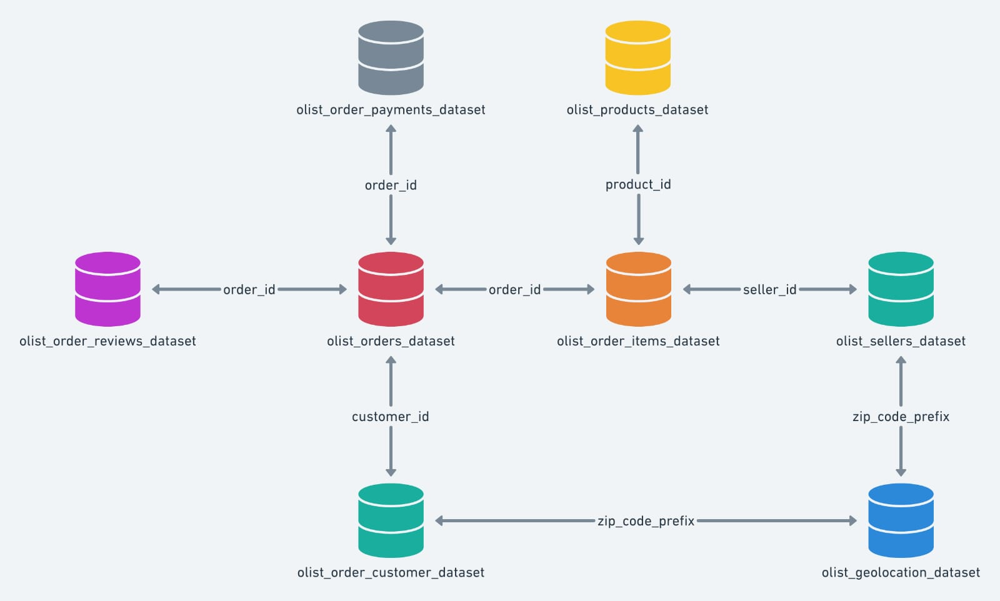

In [3]:
# Vendo as 10 linhas do arquivo de clientes
customers_df.head(10)

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP
5,879864dab9bc3047522c92c82e1212b8,4c93744516667ad3b8f1fb645a3116a4,89254,jaragua do sul,SC
6,fd826e7cf63160e536e0908c76c3f441,addec96d2e059c80c30fe6871d30d177,4534,sao paulo,SP
7,5e274e7a0c3809e14aba7ad5aae0d407,57b2a98a409812fe9618067b6b8ebe4f,35182,timoteo,MG
8,5adf08e34b2e993982a47070956c5c65,1175e95fb47ddff9de6b2b06188f7e0d,81560,curitiba,PR
9,4b7139f34592b3a31687243a302fa75b,9afe194fb833f79e300e37e580171f22,30575,belo horizonte,MG


In [4]:
# Quantas linhas e colunas tem o dataframe de clientes
customers_df.shape

(99441, 5)

<h2 style="color: #6c5b7b">Visualizando os Dados e tipos das colunas</h2>

Além de conhecer os metadados, temos também que dar uma "cheiradinha" neles! Visualizar algumas linhas, avaliar os tipos de colunas e como as diferentes bases se relacionam.

In [5]:
print("customers_df:")
display(customers_df.head())

print("\ngeo_df:")
display(geo_df.head())

print("\norderitem_df:")
display(orderitem_df.head())

print("\norderpay_df:")
display(orderpay_df.head())

print("\norderreviews_df:")
display(orderreviews_df.head())

print("\norders_df:")
display(orders_df.head())

print("\nproducts_df:")
display(products_df.head())

print("\nsellers_df:")
display(sellers_df.head())

print("\ncategname_df:")
display(categname_df.head())

customers_df:


,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP



geo_df:


,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP



orderitem_df:


,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14



orderpay_df:


,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45



orderreviews_df:


,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53



orders_df:


,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00



products_df:


,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0



sellers_df:


,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP



categname_df:


,product_category_name,product_category_name_english
0,beleza_saude,health_beauty
1,informatica_acessorios,computers_accessories
2,automotivo,auto
3,cama_mesa_banho,bed_bath_table
4,moveis_decoracao,furniture_decor


In [6]:
print("customers_df:\n")
display(customers_df.info())

print("\ngeo_df:\n")
display(geo_df.info())

print("\norderitem_df:\n")
display(orderitem_df.info())

print("\norderpay_df:\n")
display(orderpay_df.info())

print("\norderreviews_df:\n")
display(orderreviews_df.info())

print("\norders_df:\n")
display(orders_df.info())

print("\nproducts_df:\n")
display(products_df.info())

print("\nsellers_df:\n")
display(sellers_df.info())

print("\ncategname_df:\n")
display(categname_df.info())

customers_df:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 5 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   customer_id               99441 non-null  object
 1   customer_unique_id        99441 non-null  object
 2   customer_zip_code_prefix  99441 non-null  int64 
 3   customer_city             99441 non-null  object
 4   customer_state            99441 non-null  object
dtypes: int64(1), object(4)
memory usage: 3.8+ MB


None


geo_df:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000163 entries, 0 to 1000162
Data columns (total 5 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   geolocation_zip_code_prefix  1000163 non-null  int64  
 1   geolocation_lat              1000163 non-null  float64
 2   geolocation_lng              1000163 non-null  float64
 3   geolocation_city             1000163 non-null  object 
 4   geolocation_state            1000163 non-null  object 
dtypes: float64(2), int64(1), object(2)
memory usage: 38.2+ MB


None


orderitem_df:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112650 entries, 0 to 112649
Data columns (total 7 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   order_id             112650 non-null  object 
 1   order_item_id        112650 non-null  int64  
 2   product_id           112650 non-null  object 
 3   seller_id            112650 non-null  object 
 4   shipping_limit_date  112650 non-null  object 
 5   price                112650 non-null  float64
 6   freight_value        112650 non-null  float64
dtypes: float64(2), int64(1), object(4)
memory usage: 6.0+ MB


None


orderpay_df:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103886 entries, 0 to 103885
Data columns (total 5 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   order_id              103886 non-null  object 
 1   payment_sequential    103886 non-null  int64  
 2   payment_type          103886 non-null  object 
 3   payment_installments  103886 non-null  int64  
 4   payment_value         103886 non-null  float64
dtypes: float64(1), int64(2), object(2)
memory usage: 4.0+ MB


None


orderreviews_df:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 7 columns):
 #   Column                   Non-Null Count   Dtype 
---  ------                   --------------   ----- 
 0   review_id                100000 non-null  object
 1   order_id                 100000 non-null  object
 2   review_score             100000 non-null  int64 
 3   review_comment_title     11715 non-null   object
 4   review_comment_message   41753 non-null   object
 5   review_creation_date     100000 non-null  object
 6   review_answer_timestamp  100000 non-null  object
dtypes: int64(1), object(6)
memory usage: 5.3+ MB


None


orders_df:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   order_id                       99441 non-null  object
 1   customer_id                    99441 non-null  object
 2   order_status                   99441 non-null  object
 3   order_purchase_timestamp       99441 non-null  object
 4   order_approved_at              99281 non-null  object
 5   order_delivered_carrier_date   97658 non-null  object
 6   order_delivered_customer_date  96476 non-null  object
 7   order_estimated_delivery_date  99441 non-null  object
dtypes: object(8)
memory usage: 6.1+ MB


None


products_df:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32951 entries, 0 to 32950
Data columns (total 9 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   product_id                  32951 non-null  object 
 1   product_category_name       32341 non-null  object 
 2   product_name_lenght         32341 non-null  float64
 3   product_description_lenght  32341 non-null  float64
 4   product_photos_qty          32341 non-null  float64
 5   product_weight_g            32949 non-null  float64
 6   product_length_cm           32949 non-null  float64
 7   product_height_cm           32949 non-null  float64
 8   product_width_cm            32949 non-null  float64
dtypes: float64(7), object(2)
memory usage: 2.3+ MB


None


sellers_df:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3095 entries, 0 to 3094
Data columns (total 4 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   seller_id               3095 non-null   object
 1   seller_zip_code_prefix  3095 non-null   int64 
 2   seller_city             3095 non-null   object
 3   seller_state            3095 non-null   object
dtypes: int64(1), object(3)
memory usage: 96.8+ KB


None


categname_df:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 71 entries, 0 to 70
Data columns (total 2 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   product_category_name          71 non-null     object
 1   product_category_name_english  71 non-null     object
dtypes: object(2)
memory usage: 1.2+ KB


None

<h2 style="color: #6c5b7b">Renomeando Colunas</h2>

Renomenado a coluna `customer_zip_code_prefix` do `DataFrame` `customers_df` para `zip_code` e a coluna `geolocation_zip_code_prefix` do `DataFrame` `geo_df` para `zip_code`. 


In [7]:
customers_df = customers_df.rename(columns={"customer_zip_code_prefix": "zip_code"})
geo_df = geo_df.rename(columns={"geolocation_zip_code_prefix": "zip_code"})

In [8]:
customers_df.head()

,customer_id,customer_unique_id,zip_code,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


<h2 style="color: #6c5b7b">Combinando os dataframes</h2>

Este trecho de código combina os DataFrames `orders_df`, `customers_df`, `orderitem_df`, `products_df`, `categname_df`, `orderpay_df`, `sellers_df` e `orderreviews_df`, usando o método `merge()` da biblioteca `pandas`. Cada DataFrame é combinado com o próximo usando uma coluna em comum como chave de junção. 

O resultado da combinação é salvo em um novo DataFrame chamado `dados_completos`. Ao final dessa operação, o DataFrame `dados_completos` contém informações sobre os pedidos, clientes, itens do pedido, produtos, categorias de produtos, pagamentos, vendedores e avaliações de pedidos.

Esse processo de combinar vários DataFrames em um só é útil para consolidar dados dispersos em um único lugar e facilitar a análise dos dados.


In [9]:
data = orders_df.merge(customers_df, on="customer_id").merge(orderitem_df, on="order_id").merge(products_df, on="product_id").merge(categname_df, on="product_category_name").merge(orderpay_df, on="order_id").merge(sellers_df, on="seller_id").merge(orderreviews_df, on="order_id")

In [10]:
data.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,zip_code,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,payment_sequential,payment_type,payment_installments,payment_value,seller_zip_code_prefix,seller_city,seller_state,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0,housewares,1,credit_card,1,18.12,9350,maua,SP,a54f0611adc9ed256b57ede6b6eb5114,4,NaN,"Não testei o produto ainda, mas ele veio corre...",2017-10-11 00:00:00,2017-10-12 03:43:48
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0,housewares,3,voucher,1,2.00,9350,maua,SP,a54f0611adc9ed256b57ede6b6eb5114,4,NaN,"Não testei o produto ainda, mas ele veio corre...",2017-10-11 00:00:00,2017-10-12 03:43:48
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0,housewares,2,voucher,1,18.59,9350,maua,SP,a54f0611adc9ed256b57ede6b6eb5114,4,NaN,"Não testei o produto ainda, mas ele veio corre...",2017-10-11 00:00:00,2017-10-12 03:43:48
3,128e10d95713541c87cd1a2e48201934,a20e8105f23924cd00833fd87daa0831,delivered,2017-08-15 18:29:31,2017-08-15 20:05:16,2017-08-17 15:28:33,2017-08-18 14:44:43,2017-08-28 00:00:00,3a51803cc0d012c3b5dc8b7528cb05f7,3366,sao paulo,SP,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-08-21 20:05:16,29.99,7.78,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0,housewares,1,credit_card,3,37.77,9350,maua,SP,b46f1e34512b0f4c74a72398b03ca788,4,NaN,Deveriam embalar melhor o produto. A caixa vei...,2017-08-19 00:00:00,2017-08-20 15:16:36
4,0e7e841ddf8f8f2de2bad69267ecfbcf,26c7ac168e1433912a51b924fbd34d34,delivered,2017-08-02 18:24:47,2017-08-02 18:43:15,2017-08-04 17:35:43,2017-08-07 18:30:01,2017-08-15 00:00:00,ef0996a1a279c26e7ecbd737be23d235,2290,sao paulo,SP,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-08-08 18:37:31,29.99,7.78,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0,housewares,1,credit_card,1,37.77,9350,maua,SP,dc90f19c2806f1abba9e72ad3c350073,5,NaN,"Só achei ela pequena pra seis xícaras ,mais é ...",2017-08-08 00:00:00,2017-08-08 23:26:23


Temos ids de pedidos duplicados. Isso se deve ao fato de que o mesmo pedido pode ser pago com vários métodos de pagamento diferentes.

<h2 style="color: #6c5b7b">Valores Faltantes</h2>

In [11]:
# Porcentagem de valores nulos
(100 * data.isna().sum() / len(data) ).sort_values(ascending=False)

review_comment_title             87.994613
review_comment_message           57.216013
order_delivered_customer_date     2.157298
order_delivered_carrier_date      1.040478
order_approved_at                 0.012009
product_length_cm                 0.000858
product_height_cm                 0.000858
product_width_cm                  0.000858
product_weight_g                  0.000858
payment_installments              0.000000
product_category_name_english     0.000000
payment_sequential                0.000000
payment_type                      0.000000
order_id                          0.000000
payment_value                     0.000000
seller_zip_code_prefix            0.000000
seller_city                       0.000000
review_id                         0.000000
review_score                      0.000000
review_creation_date              0.000000
seller_state                      0.000000
product_description_lenght        0.000000
product_photos_qty                0.000000
customer_id

<h2 style="color: #6c5b7b">Estatística descritiva básica</h2>

In [12]:
# Estatística descritiva básica
data.describe()

,zip_code,order_item_id,price,freight_value,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,payment_sequential,payment_installments,payment_value,seller_zip_code_prefix,review_score
count,116581.000000,116581.000000,116581.000000,116581.000000,116581.000000,116581.000000,116581.000000,116580.000000,116580.00000,116580.000000,116580.000000,116581.000000,116581.000000,116581.000000,116581.000000,116581.000000
mean,35053.391556,1.196953,120.751369,20.062550,48.766317,785.949331,2.204991,2115.560422,30.31858,16.645891,23.116898,1.093369,2.949614,172.910258,24504.889030,4.017507
std,29817.864821,0.701350,183.848421,15.845515,10.033728,652.614023,1.717417,3783.587898,16.22276,13.474741,11.758687,0.727240,2.783798,267.622516,27625.157426,1.397886
min,1003.000000,1.000000,0.850000,0.000000,5.000000,4.000000,1.000000,0.000000,7.00000,2.000000,6.000000,1.000000,0.000000,0.000000,1001.000000,1.000000
25%,11310.000000,1.000000,39.900000,13.080000,42.000000,346.000000,1.000000,300.000000,18.00000,8.000000,15.000000,1.000000,1.000000,61.000000,6429.000000,4.000000
50%,24315.000000,1.000000,74.900000,16.320000,52.000000,600.000000,1.000000,700.000000,25.00000,13.000000,20.000000,1.000000,2.000000,108.190000,13690.000000,5.000000
75%,58600.000000,1.000000,134.900000,21.220000,57.000000,983.000000,3.000000,1800.000000,38.00000,20.000000,30.000000,1.000000,4.000000,189.720000,28495.000000,5.000000
max,99980.000000,21.000000,6735.000000,409.680000,76.000000,3992.000000,20.000000,40425.000000,105.00000,105.000000,118.000000,29.000000,24.000000,13664.080000,99730.000000,5.000000


<h1 style="color: #6c5b7b">Perguntas de negócio</h1>

<h2 style="color: #6c5b7b">Como estão distribuídas as avaliações (reviews)?</h2>



In [13]:
fig = px.histogram(data, x="review_score")
fig.show()

In [14]:
percentage = data["review_score"].value_counts(normalize=True) * 100

fig = px.bar(percentage, x=percentage.index, y=percentage.values, text=percentage.values, labels={"x": "Nota", "y": "Percentagem"})
fig.update_traces(texttemplate='%{text:.2f}%', textposition='outside')
fig.show()


**Mais de 75% dos clientes deram uma pontuação igual ou maior que 4. 12,5% deram uma pontuação de 1 e cerca de 12% deram uma pontuação de 3 ou 2.**

<h2 style="color: #6c5b7b">Proporção de clientes gerando a maior parte da receita.</h2>


<p>A <strong>Análise de Pareto</strong> é uma técnica importante para identificar e priorizar os elementos mais relevantes em um conjunto de dados, permitindo a concentração de esforços nas áreas mais críticas e relevantes, maximizando resultados e minimizando custos. É uma ferramenta simples e de fácil aplicação.</p>

<p>É a famosa regra 20/80, 20% que representam 80% do resultado</p>

<p>Podemos utilizar para várias análises! Vamos começar com a proporção de clientes que mais gastam.</p>


In [15]:
# Clientes com o maior número cumulativo de pedidos (em pagamentos).
top_customers = data.groupby("customer_unique_id")["payment_value"].sum().reset_index().sort_values("payment_value", ascending=False)
top_customers.rename(columns={"payment_value":"total_paid"}, inplace=True)

In [16]:
# calcular as colunas "% of Total Sales" e "Cum % of Total Sales"
top_customers["% of Total Sales"] = (top_customers["total_paid"] / top_customers["total_paid"].sum()) * 100
top_customers["Cum % of Total Sales"] = top_customers["% of Total Sales"].cumsum()

In [17]:

fig = px.line(top_customers, x=range(1, len(top_customers) + 1), y="Cum % of Total Sales")

# definir as etiquetas do eixo x e y e o título do gráfico
fig.update_layout(
    xaxis_title="Número de Clientes",
    yaxis_title="Total Vendas Cumulativo %",
    title="Contribuição % para as vendas por número de clientes"
)

# adicionar uma linha de preenchimento abaixo do gráfico
fig.add_shape(
    type="rect",
    xref="x",
    yref="paper",
    x0=0,
    y0=0,
    x1=40000,
    y1=1,
    fillcolor="green",
    opacity=0.2,
    layer="below"
)

# atualizar o layout da forma para ajustar a altura do preenchimento
fig.update_shapes(dict(xref='x', yref='paper'))

# adicionar um texto explicativo na figura
fig.add_annotation(
    x=55000,
    y=75,
    text="40k clientes (+-42% do total)<br> representam +-80% das vendas",
    font=dict(
        size=14,
        color="black"
    ),
    showarrow=False,
)

# exibir a figura
fig.show()

<h2 style="color: #6c5b7b">Quem são os clientes que mais gastam?</h2>


Os resultados dessa análise podem gerar diversos insights para a área de marketing! Por exemplo:
- Monitorar os clientes que mais gastam-
- Oferecer promoções
- Tentar vender mais produtos
- Realizar entregas personalizadas





In [18]:
# renomear a coluna "payment_value" para "total_paid"
top_customers.rename(columns={"payment_value" : "total_paid"}, inplace=True)

# criar um gráfico de barras do Plotly
fig = px.bar(top_customers[:10], x="total_paid", y="customer_unique_id", orientation="h")

# atualizar as configurações de layout do gráfico
fig.update_layout(
    title="Top 10 Clientes por Valor Total Pago",
    xaxis_title="Valor Total Pago",
    yaxis_title="ID do Cliente Único"
)

# exibir o gráfico
fig.show()


<h2 style="color: #6c5b7b">Principais cidades por número de pedidos por estado.</h2>






In [19]:
# agrupar o dataframe por "customer_state" e contar o número de "order_id" por estado
top_orders_cities = data.groupby("customer_state")["order_id"].count().reset_index().sort_values("order_id", ascending=False)

# renomear a coluna "order_id" para "count"
top_orders_cities.rename(columns={"order_id":"count"}, inplace=True)

# criar um gráfico de barras do Plotly
fig = px.bar(top_orders_cities[:10], x="count", y="customer_state", orientation="h")

# atualizar as configurações de layout do gráfico
fig.update_layout(
    title="TOP 10 Estados por Número de Pedidos",
    xaxis_title="Número de Pedidos",
    yaxis_title="Estado"
)

# exibir o gráfico
fig.show()


<h2 style="color: #6c5b7b">Cidades com maior geração de receita.</h2>





In [20]:
top_ordersbyvalue_cities = data.groupby("customer_city")["payment_value"].sum().reset_index().sort_values("payment_value", ascending=False)
top_ordersbyvalue_cities["% of Total Payments"] = (top_ordersbyvalue_cities["payment_value"] / top_ordersbyvalue_cities["payment_value"].sum()) * 100
top_ordersbyvalue_cities["Cum % of Total Payments"] = top_ordersbyvalue_cities["% of Total Payments"].cumsum() 

In [21]:
# criar um gráfico de barras do Plotly
fig = px.bar(top_ordersbyvalue_cities[:10], x="% of Total Payments", y="customer_city", orientation="h")

# atualizar as configurações de layout do gráfico
fig.update_layout(
    title="TOP 10 Cidades por Geração de Receita",
    xaxis_title="Porcentagem do Total de Pagamentos",
    yaxis_title="Cidade do Cliente"
)

# exibir o gráfico
fig.show()


In [22]:
# criar um gráfico de linha do Plotly
fig = px.line(top_ordersbyvalue_cities, x=range(1, len(top_ordersbyvalue_cities)+1), y="Cum % of Total Payments")

# atualizar as configurações de layout do gráfico
fig.update_layout(
    title="% de Contribuição das Vendas por Número de Cidades",
    xaxis_title="Número de Cidades",
    yaxis_title="% de Contribuição para as Vendas"
)

# preencher a área abaixo da curva
fig.add_shape(
    type="rect",
    xref="x",
    yref="y",
    x0=0,
    y0=0,
    x1=358,
    y1=top_ordersbyvalue_cities["Cum % of Total Payments"][357],
    fillcolor="green",
    opacity=0.3,
    layer="below",
    line_width=0
)

# adicionar um texto ao gráfico
fig.add_annotation(
    x=1000,
    y=70,
    text="358 cidades (+-8,7% do total) <br>contribuem para +-80% das vendas.",
    font=dict(
        size=14,
        color="black"
    ),
    showarrow=False
)

# exibir o gráfico
fig.show()


In [23]:
print("Número de cidades que contribuem com 80% das vendas totais:",
      len(top_ordersbyvalue_cities[top_ordersbyvalue_cities["Cum % of Total Payments"] <= 80]),
      "ou em in %:",
      (len(top_ordersbyvalue_cities[top_ordersbyvalue_cities["Cum % of Total Payments"] <= 80]) / len(top_ordersbyvalue_cities)) * 100)

Número de cidades que contribuem com 80% das vendas totais: 356 ou em in %: 8.693528693528693


<h2 style="color: #6c5b7b">Como os pedidos variam ao longo do tempo?</h2>


<p>Como os pedidos são feitos ao longo do dia? Por exemplo, quando se está vendendo mais ou menos, em quais horários e dias das semana?</p>



In [24]:
# Total de pedidos por hora e dia da semana
# Mas antes precisamos converter as colunas de datas para datetime
datesCols = ["order_purchase_timestamp", "order_approved_at", "order_delivered_carrier_date", 
            "order_delivered_customer_date", "order_estimated_delivery_date", "shipping_limit_date", 
            "review_creation_date", "review_answer_timestamp"]

for col in datesCols:
    data[col] = pd.to_datetime(data[col])

In [25]:
# Orders by hour
orders_df["order_purchase_timestamp"] = pd.to_datetime(orders_df["order_purchase_timestamp"])
orderbyhour = orders_df.groupby(orders_df["order_purchase_timestamp"].dt.hour)["order_id"].count().reset_index().sort_values(by="order_purchase_timestamp", ascending=False)
orderbyhour.rename(columns={"order_id":"Total Orders", "order_purchase_timestamp": "Hour of Day"}, inplace=True)

In [26]:
fig = px.bar(orderbyhour, x='Hour of Day', y='Total Orders', title='Número de pedidos por hora do dia')
fig.update_xaxes(title='Hora do dia')
fig.update_yaxes(title='Número total de pedidos')
fig.show()


Os pedidos começam a aumentar por volta das 6h da manhã e atingem o pico às 4 da tarde.

In [27]:
# Orders by day of the week
orderbydow = data.groupby(data["order_purchase_timestamp"].dt.day_name())["order_id"].count().reset_index()
orderbydow.rename(columns={"order_id":"Total Orders", "order_purchase_timestamp": "Weekday Name"}, inplace=True)
orderbydow = orderbydow.sort_values(by="Total Orders", ascending=False)

In [57]:
#fig = px.bar(orderbydow, x='Weekday Name', y='Total Orders', title='Número de pedidos por dia da semana')
#fig.update_xaxes(title='Dia da semana')
#fig.update_yaxes(title='Número total de pedidos')
#fig.show()


In [29]:
# Define a ordem dos dias da semana
weekday_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

# Converte a coluna "Weekday Name" em uma categoria ordenada
weekday = pd.Categorical(orderbydow['Weekday Name'], categories=weekday_order, ordered=True)

# Cria um novo dataframe ordenado pela coluna de categoria "weekday"
orderbydow_ordered = orderbydow.assign(weekday=weekday).sort_values('weekday')

# Cria um gráfico de barras com os dias da semana em ordem
fig = px.bar(orderbydow_ordered, x='weekday', y='Total Orders', title='Número de pedidos por dia da semana')
fig.update_xaxes(title='Dia da semana')
fig.update_yaxes(title='Número total de pedidos')
fig.show()


Os pedidos atingem o pico no início da semana (segunda e terça-feira) e começam a declinar um pouco depois. Durante o final de semana, observa-se uma diminuição acentuada dos pedidos.

<h2 style="color: #6c5b7b">Como os produtos são avaliados?</h2>






In [30]:
reviewsocres = data.groupby("product_category_name")["review_score"].agg(["mean", "count"]).sort_values(by="mean",ascending=False)
bestrated = reviewsocres[reviewsocres["count"]>=30][:10]

fig = go.Figure(go.Bar(
            x=bestrated['mean'],
            y=bestrated.index,
            orientation='h'))

fig.update_layout(
    title='Produtos com as melhores avaliações',
    xaxis_title='Avaliação média',
    yaxis_title='Categoria do produto',
    height=600,
    width=800,
    margin=dict(l=100, r=20, t=50, b=50),
)

fig.show()


In [31]:
reviewsocres = data.groupby("product_category_name")["review_score"].agg(["mean", "count"]).sort_values(by="mean",ascending=False)
worstrated = reviewsocres[reviewsocres["count"]>=30].sort_values(by='mean')[:10]

fig = go.Figure(go.Bar(
            x=worstrated['mean'],
            y=worstrated.index,
            orientation='h'))

fig.update_layout(
    title='Produtos com as piores avaliações',
    xaxis_title='Avaliação média',
    yaxis_title='Categoria do produto',
    height=600,
    width=800,
    margin=dict(l=100, r=20, t=50, b=50),
)

fig.show()


<h2 style="color: #6c5b7b">O método de pagamento afeta o status do pedido?</h2>


<p>.</p>



In [32]:
# Por exemplo: o pagamento em dinheiro aumenta o cancelamento de pedidos?
cashvscancel = pd.crosstab(data["payment_type"], data["order_status"])
cashvscancel = cashvscancel[["canceled", "delivered"]]
cashvscancel["% Canceled"] = (cashvscancel["canceled"] / cashvscancel["delivered"] ) * 100
cashvscancel["Avg Cancelation Rate"] = (len(data[data["order_status"] == "canceled"]) / len(data[data["order_status"] == "delivered"])) * 100
cashvscancel


order_status,canceled,delivered,% Canceled,Avg Cancelation Rate
payment_type,,,,
boleto,92,22196,0.414489,0.484803
credit_card,428,84174,0.508471,0.484803
debit_card,6,1630,0.368098,0.484803
voucher,27,6067,0.445030,0.484803


É possível observar que a taxa de cancelamento é praticamente a mesma em todos os métodos de pagamento. Mas notamos uma leve desvio acima da média para o cartão de crédito.

<h2 style="color: #6c5b7b">Existe alguma relação entre o tempo de entrega e as pontuações das avaliações?</h2>


<p>.</p>



In [33]:
# Adicionando uma coluna delta que calcula o tempo que levou para o pedido ser entregue
data["TimeToDeliveryinHours"] = (data["order_delivered_customer_date"] - data["order_purchase_timestamp"])
data["TimeToDeliveryinHours"] = data["TimeToDeliveryinHours"].apply(lambda x: x.total_seconds())
data["TimeToDeliveryinHours"] = round((data["TimeToDeliveryinHours"] / 3600) / 24, 2)
data.rename(columns={"TimeToDeliveryinHours" : "TimeToDeliveryinDays"}, inplace=True)

In [34]:
# Principais estatísticas do tempo de entrega
data[["TimeToDeliveryinDays"]].describe()

,TimeToDeliveryinDays
count,114066.000000
mean,12.484983
std,9.439075
min,0.530000
25%,6.750000
50%,10.200000
75%,15.550000
max,209.630000


O tempo médio de entrega é relativamente alto (12,44 dias), com mediana de (10,19 dias). Observamos um valor extremo atípico de 208 dias.

O boxplot é um gráfico que mostra como um conjunto de dados está distribuído, destacando informações como a mediana (valor que divide os dados em duas partes iguais), os valores mínimo e máximo e a presença de dados incomuns. Ele é útil para identificar a forma como os dados estão agrupados e se existem pontos que se destacam do restante do conjunto.

In [58]:

# Define a ordem crescente dos valores da pontuação de avaliação
score_order = sorted(data['review_score'].unique())

# Converte a coluna "review_score" em uma categoria ordenada
score = pd.Categorical(data['review_score'], categories=score_order, ordered=True)

# Cria um novo dataframe ordenado pela coluna de categoria "score"
data_ordered = data.assign(score=score).sort_values('score')

# Cria um seletor de pontuação de avaliação em ordem crescente
fig = px.box(data_ordered, x='score', y='TimeToDeliveryinDays', color='score',
             title='Relação entre a nota da avaliação e o tempo de entrega')

fig.update_xaxes(title='Pontuação da avaliação')
fig.update_yaxes(title='Tempo de entrega (dias)')

fig.show()


Podemos ver que temos vários valores atípicos(outliers). Estes são pedidos que demoraram muito para serem entregues por algum motivo.

In [36]:
# Define o limite superior dos valores
q_high = data["TimeToDeliveryinDays"].quantile(0.95)

# Cria um novo dataframe sem os valores atípicos
data_no_outliers = data[data["TimeToDeliveryinDays"] < q_high]

# Define a ordem crescente dos valores da pontuação de avaliação
score_order = sorted(data_no_outliers['review_score'].unique())

# Converte a coluna "review_score" em uma categoria ordenada
score = pd.Categorical(data_no_outliers['review_score'], categories=score_order, ordered=True)

# Cria um novo dataframe com a coluna de categoria "score"
data_score = data_no_outliers.assign(score=score)

data_score = data_score.assign(score=score).sort_values('score')

# Cria um seletor de pontuação de avaliação em ordem crescente
fig = px.box(data_score, x='score', y='TimeToDeliveryinDays', color='score',
             title='Relação entre a pontuação da avaliação e o tempo de entrega')

fig.update_xaxes(title='Pontuação da avaliação', categoryorder='array', categoryarray=score_order)
fig.update_yaxes(title='Tempo de entrega (dias)')

fig.show()


Nossa hipótese inicial é confirmada. Podemos claramente observar uma relação direta entre o tempo de entrega e a pontuação da avaliação. À medida que o tempo de entrega diminui, a pontuação da avaliação tende a aumentar.

<h2 style="color: #6c5b7b">Quais são as cidades dos vendedores com menor/maior tempo de entrega?</h2>


<p>.</p>



In [37]:
# Vendedores com melhor tempo de entrega
sellersdeliverytime = data.groupby("seller_city")["TimeToDeliveryinDays"].agg(["min", "max", "mean", "std", "count" ]).dropna().sort_values("mean").reset_index()
# Filtro para vendedores com 30 ou mais pedidos em seu histórico
sellersdeliverytime = sellersdeliverytime[sellersdeliverytime["count"]>=30]

In [38]:
fastestdeliverysellers = sellersdeliverytime[:10]
slowestdeliverysellers = sellersdeliverytime.sort_values("mean", ascending=False)[:10]

In [39]:
# Vendedores com entrega mais rápida.
fastestdeliverysellers

,seller_city,min,max,mean,std,count
14,varzea paulista,2.58,21.07,5.877297,3.284975,37
39,hortolandia,1.39,71.09,7.574929,6.654358,353
53,ribeirao preto / sao paulo,2.45,27.32,7.944500,4.055726,40
60,vicente de carvalho,1.54,42.43,8.144449,6.593567,227
61,ferraz de vasconcelos,1.17,20.84,8.186316,6.443319,38
63,rio claro,1.70,34.88,8.208621,6.247392,116
69,poa,1.09,38.20,8.564489,6.003138,176
71,carazinho,3.16,19.13,8.640656,3.858348,61
79,betim,1.24,53.85,8.818312,6.242661,314
85,maua,1.51,42.57,8.977052,5.450293,485


In [40]:
# Vendedores com entrega mais lenta.
slowestdeliverysellers

,seller_city,min,max,mean,std,count
516,mombuca,6.03,88.24,22.921515,17.782976,33
510,itaquaquecetuba,1.61,194.85,21.873921,12.964951,1747
508,congonhal,4.31,60.82,21.590463,12.736508,108
505,balneario camboriu,3.25,79.36,20.641613,17.449918,31
504,tubarao,6.01,81.33,19.930286,20.308568,35
500,foz do iguacu,2.98,92.78,19.609036,17.262743,197
492,bombinhas,5.13,68.10,18.875761,9.758911,92
491,criciuma,3.73,71.16,18.396000,15.760557,35
489,claudio,5.73,48.63,18.294308,8.246739,130
482,caucaia,3.14,138.88,17.841471,23.052995,34


In [41]:
# Junte a pontuação média de avaliação à tabela acima.
avg_review_score_seller = data.groupby("seller_city")["review_score"].mean().dropna().sort_values(ascending=False).reset_index()

In [42]:
sellerPerf = sellersdeliverytime.merge(avg_review_score_seller, on="seller_city")

In [43]:
# Gráfico de regressão linear entre a média de tempo de entrega e a média da pontuação de avaliação
fig = px.scatter(sellerPerf, x='mean', y='review_score', trendline='ols', 
                 title='Relação entre a média de tempo de entrega e a média da pontuação de avaliação')

fig.update_xaxes(title='Média de tempo de entrega (dias)')
fig.update_yaxes(title='Média da pontuação de avaliação')

fig.show()


<h2 style="color: #6c5b7b">Estados com maior/menor tempo de entrega.</h2>


<p>.</p>



In [44]:
# Top 10 estados com o maior tempo médio de entrega
highestTTDstates = data.groupby("customer_state")["TimeToDeliveryinDays"].mean().dropna().sort_values(ascending=False).reset_index()
highestTTDstates = highestTTDstates[:10]

# Gráfico de barras com o tempo médio de entrega por estado
fig = px.bar(highestTTDstates, x='TimeToDeliveryinDays', y='customer_state',
             orientation='h', title='Top 10 estados com o maior tempo médio de entrega')

fig.update_yaxes(title='Estado')
fig.update_xaxes(title='Tempo médio de entrega (dias)')

fig.show()


In [45]:
# Top 10 estados com o menor tempo médio de entrega
lowestTTDstates = data.groupby("customer_state")["TimeToDeliveryinDays"].mean().dropna().sort_values(ascending=True).reset_index()
lowestTTDstates = lowestTTDstates[:10]

# Gráfico de barras com o tempo médio de entrega por estado
fig = px.bar(lowestTTDstates, x='TimeToDeliveryinDays', y='customer_state',
             orientation='h', title='Top 10 estados com o menor tempo médio de entrega')

fig.update_yaxes(title='Estado')
fig.update_xaxes(title='Tempo médio de entrega (dias)')

fig.show()



<h2 style="color: #6c5b7b">Como o tempo médio de entrega varia ao longo do tempo?</h2>


<p>.</p>



In [46]:
# Mediana do tempo de entrega por ano
deliverytimevstime = data.groupby(data["order_purchase_timestamp"].dt.year)["TimeToDeliveryinDays"].median().dropna()

# Converte ano em categoria (e não um número)
deliverytimevstime.index = deliverytimevstime.index.astype(str)

# Gráfico de barras com a mediana do tempo de entrega por ano
fig = px.bar(deliverytimevstime, x=deliverytimevstime.index, y='TimeToDeliveryinDays',
             title='Mediana do tempo de entrega por ano')

fig.update_xaxes(title='Ano')
fig.update_yaxes(title='Mediana de entrega em dias')

fig.show()


Podemos ver que a empresa fez uma melhoria significativa no tempo de entrega. Em 2016, o tempo médio de entrega excedia 17 dias, enquanto em 2017 ele caiu para cerca de 12 dias e para cerca de 9 dias em 2018.

<h2 style="color: #6c5b7b">Como a pontuação média das avaliações varia ao longo do tempo?</h2>


<p>.</p>



In [47]:
# Média da pontuação da avaliação por ano
scorevstime = data.groupby(data["order_purchase_timestamp"].dt.year)["review_score"].mean().dropna()

# Converte o índice do grupo em uma categoria
scorevstime.index = scorevstime.index.astype(str)

# Gráfico de barras com a média da pontuação da avaliação por ano
fig = px.bar(scorevstime, x=scorevstime.index, y='review_score',
             title='Média da pontuação da avaliação por ano')

fig.update_xaxes(title='Ano')
fig.update_yaxes(title='Pontuação média da avaliação')

fig.show()


Os clientes estão dando pontuações melhores em 2017 e 2018 do que em 2016.

<h2 style="color: #6c5b7b">Quais são as categorias de produtos mais vendidas?</h2>


<p>.</p>


In [48]:
top_categ_by_revenue = data.groupby("product_category_name").agg({'order_id':'nunique','payment_value':'sum'}).sort_values("payment_value", ascending=False)[:10]
top_categ_by_revenue.rename(columns={"order_id":"NumOfOrders", "payment_value":"Revenues"}, inplace=True)

In [49]:
top_categ_by_revenue

,NumOfOrders,Revenues
product_category_name,,
cama_mesa_banho,9417,1744205.53
beleza_saude,8835,1663076.30
informatica_acessorios,6689,1599574.66
moveis_decoracao,6449,1444383.69
relogios_presentes,5624,1430553.48
esporte_lazer,7720,1400270.11
utilidades_domesticas,5884,1097900.09
automotivo,3897,855095.68
ferramentas_jardim,3518,840721.59


<h2 style="color: #6c5b7b"> tempo de entrega em dias por Estado</h2>

Para fazer isso, foi utilizado um arquivo que tem as delimitações dos estados brasileiros em forma de polígonos. Pode-se encontrar esse arquivo [aqui](https://github.com/fititnt/gis-dataset-brasil/tree/master/uf/geojson)

<p>Para ler o arquivo, foi utilizado  o <strong>Geopandas</strong>!</p>

In [50]:
# Agrupar os dados por estado e obter a média do tempo de entrega
mean_delivery_time_by_state = data.groupby('customer_state')['TimeToDeliveryinDays'].mean().reset_index()

mean_delivery_time_by_state

,customer_state,TimeToDeliveryinDays
0,AC,20.544348
1,AL,24.575918
2,AM,26.445536
3,AP,28.109759
4,BA,19.221472
5,CE,20.706714
6,DF,12.954965
7,ES,15.678860
8,GO,15.250782
9,MA,21.677985


In [51]:
import geopandas as gpd

geojson_file = './data/raw/uf.json'
geojson_data = gpd.read_file(geojson_file)

In [52]:
geojson_data.head(10)

,UF_05,MICRO,MESO,REGIAO,NOME_UF,GEOCODIGO,geometry
0,AC,BRASILEIA,VALE DO ACRE,Norte,Acre,12,"POLYGON ((-73.80098 -7.11146, -73.73763 -7.134..."
1,AL,ALAGOANA DO SERTAO DO SAO FRANCISCO,AGRESTE ALAGOANO,Nordeste,Alagoas,27,"POLYGON ((-38.23724 -9.32937, -38.20273 -9.296..."
2,AM,ALTO SOLIMOES,CENTRO AMAZONENSE,Norte,Amazonas,13,"POLYGON ((-73.80098 -7.11146, -73.79617 -7.102..."
3,AP,AMAPA,NORTE DO AMAPA,Norte,Amap,16,"POLYGON ((-54.87178 2.43408, -54.79692 2.43935..."
4,BA,ALAGOINHAS,CENTRO NORTE BAIANO,Nordeste,Bahia,29,"POLYGON ((-46.60921 -11.25550, -46.58164 -11.2..."
5,CE,BAIXO CURU,CENTRO-SUL CEARENSE,Nordeste,Cear,23,"POLYGON ((-41.41398 -3.34957, -41.41194 -3.340..."
6,DF,BRASILIA,DISTRITO FEDERAL,Centro-Oeste,DF,53,"POLYGON ((-48.28216 -15.82915, -48.26746 -15.8..."
7,ES,AFONSO CLAUDIO,CENTRAL ESPIRITO-SANTENSE,Sudeste,Esp rito Santo,32,"MULTIPOLYGON (((-41.87939 -20.75908, -41.87372..."
8,GO,ANAPOLIS,CENTRO GOIANO,Centro-Oeste,Goi s,52,"POLYGON ((-53.25072 -17.61863, -53.24694 -17.6..."
9,MA,AGLOMERACAO URBANA DE SAO LUIS,CENTRO MARANHENSE,Nordeste,Maranh o,21,"MULTIPOLYGON (((-48.75472 -5.34878, -48.58427 ..."


In [53]:
geojson_data['tempo_entrega'] = mean_delivery_time_by_state['TimeToDeliveryinDays']

geojson_data.head()

,UF_05,MICRO,MESO,REGIAO,NOME_UF,GEOCODIGO,geometry,tempo_entrega
0,AC,BRASILEIA,VALE DO ACRE,Norte,Acre,12,"POLYGON ((-73.80098 -7.11146, -73.73763 -7.134...",20.544348
1,AL,ALAGOANA DO SERTAO DO SAO FRANCISCO,AGRESTE ALAGOANO,Nordeste,Alagoas,27,"POLYGON ((-38.23724 -9.32937, -38.20273 -9.296...",24.575918
2,AM,ALTO SOLIMOES,CENTRO AMAZONENSE,Norte,Amazonas,13,"POLYGON ((-73.80098 -7.11146, -73.79617 -7.102...",26.445536
3,AP,AMAPA,NORTE DO AMAPA,Norte,Amap,16,"POLYGON ((-54.87178 2.43408, -54.79692 2.43935...",28.109759
4,BA,ALAGOINHAS,CENTRO NORTE BAIANO,Nordeste,Bahia,29,"POLYGON ((-46.60921 -11.25550, -46.58164 -11.2...",19.221472


In [54]:
fig = px.choropleth_mapbox(geojson_data, 
                           geojson=geojson_data.geometry, 
                           locations=geojson_data.index, 
                           color='tempo_entrega',
                           color_continuous_scale='YlOrRd',
                           mapbox_style='open-street-map',
                           zoom=3, center={'lat': -15.788497, 'lon': -47.879873},
                           opacity=0.5)

fig.show()


<h2 style="color: #6c5b7b">Referências</h2>

- [Brazilian Ecommerce EDA + RFM + NMF Notebook 1](https://www.kaggle.com/code/rajivaiml/brazilian-ecommerce-eda-rfm-nmf)
- [GIS Dataset](https://github.com/fititnt/gis-dataset-brasil/tree/master/uf/geojson)